In [1]:
# Importing important libraries for this lab 
import matplotlib #To plot our epochs and outcomes
import numpy as np #To use the summation and square function and compute arrays
import pandas as pd #To traverse through the array and read the .csv file
import matplotlib.pyplot as plot
#.........Special 'pandas' function.........
pd.options.mode.chained_assignment = None #I have used this function from the pandas library as it helps to reduce run time
#our dataframe is 'd' throughout the lab 

In [2]:
# Defining Functions and assigning Parameter:
# ppc() gives us the percentage of cancer patient w.r.t patients with chd

def ppc(d): #Here 'd' is the 2-D dataframe we compute for 
    rowct_d = len(d)  # Get total number of rows.

    d1cancer = d[d['chd'] == 1] # Accessing the array of patients that have CHD w.r.t given data....OUTPUT is 0/1
    d1cancerct = len(d1cancer.index)  # Computes the total number of cancer positive cases
    d0cancer = d[d['chd'] == 0]
    d0cancerct = len(d0cancer.index)  # Computes the total number of cancer negative cases

    cancer1percentage = (d1cancerct / rowct_d) * 100 # Gives the percentage of each class: cancer and no cancer.
    cancer0percentage = (d0cancerct / rowct_d) * 100
    cancer1percentage = round(cancer1percentage, 2) # Gives us the rounded value to 2 nearest digits (0-99)
    cancer0percentage = round(cancer0percentage, 2)
    
    print("Percentage of no cancer cases - ", cancer0percentage, "%")
    print("Percentage of cancer - ", cancer1percentage, "%")

# Implementing correlation matrix funtion and assigning Parameter:
# comat() gives us the correlation between features with parameter 'd' which is used to compute the base matrix

def comat(d):
    f = plot.figure(figsize=(7, 7)) # Size of plot is 7 by 7
    plot.matshow(d.corr(), fignum=f.number) #  Find the pairwise correlation of all columns in the dataframe
    plot.xticks(range(d.shape[1]), d.columns, fontsize=12, rotation=45)
    plot.yticks(range(d.shape[1]), d.columns, fontsize=12) 
    colorb = plot.colorbar() # Gives us the correlation plot of variables
    colorb.ax.tick_params(labelsize=12) # Matplotlib function that controls behavior of major tick locators 

    print("Feature pairs with high correlation amongst variables (Below 1.0/Around 0.8):")
    print("[typea, adiposity]\n[alcohol, adiposity]")
    
# Implementing 'one hot encoding' algorithm and assigning Parameter:
# This algorithm computes for the paitents family history with CHD 

def onehot_encode(d):
    encodefamh = pd.get_dummies(d['famhist'])  # Encoding family history (famhist) column and stores the data as an indicator variable
    d = d.drop('famhist', axis=1)  # Drop non-encoded famhist value.
    d = d.join(encodefamh)  # Add encoded famhist value.
    return d 


# Defining standardization function to Standardizes our numerical features and here we also assign a Parameter.

def stdard(d):
    for feat in (d[['sbp', 'tobacco', 'ldl', 'adiposity', 'typea', 'obesity','alcohol', 'age']]):
        mean = d[feat].mean(axis=0)  # Computes mean of the entire coloumn of data.
        stdev = d[feat].std(axis=0)  # Computes standard deviation of the entire coloumn of data.
        for i in range(len(d[feat])): # Here, we Standardize each column/row in the array d and ittrates i times.
            d.loc[d.index[i], feat] = (d.loc[d.index[i], feat] - mean) / stdev # Using loc for indexing


# Calculating z = beta0 + beta1*x1 + ....... + betan*xn (Hypothesis w.r.t Normal Equations)
# w - dataframe of w to use in z calculation
def log_odds(d, w):
    rowsd = len(d)
    columnsd = len(d.columns)
    zcol = pd.DataFrame([], columns=['z value']) 

    for i in range(rowsd): # Matrix operations by iterating through rows and columns
        z = w.iloc[0, 1] # To calculate z, we use w as the dataframe and .iloc for indexing
        for j in range(columnsd):
            z = z + (w.iloc[j, 1] * d.iloc[i, j])
        zcol = zcol.append({'z value': z}, ignore_index=True) # Here I used pd library to append 

    d['z value'] = zcol['z value'].to_numpy() # Appends zcol to dataframe d
    print(d) # Output d 

    
# Defining our hypothesis using sigmoid().
# Probability function, P(z) : returns probability, here, w is provided as defined above
# Where input, z = beta0 + beta1*x1 + ....... + betan*xn

def sigmoid(z): # z - log(odds), defined in the above function
    p = 1 / (1 + np.exp(-z)) # Defining p using the numpy's library
    return p # p -(A probability value: (0-1))

# Now, we define a sigmoid function to compute probability p for each row in dataframe (d)


def prob(d):
    rowsd = len(d)
    pcol = pd.DataFrame([], columns=['p value'])

    for i in range(rowsd):
        p = sigmoid(z=d.iloc[i, -1])
        pcol = pcol.append({'p value': p}, ignore_index=True)
    d['p value'] = pcol['p value'].to_numpy() # Appends zcol to dataframe d
    print(d)

# Implementing binary cross entropy loss function: logloss()

def logloss(targd, featsd): # targd - the target dataframe and featsd - the features dataframe
    e = 0 # Initial stage
    m = len(targd)  # Same value as that of len(featsd)
    for i in range(m):
        e = e + targd.iloc[i, -1] * np.log(featsd.iloc[i, -1]) + (1 - targd.iloc[i, -1]) * np.log(1 - featsd.iloc[i, -1])
    return (-1/m) * e # Returns:  e which is the logloss (cost/error)

# Defining Batch Gradient Descentand mini-Batch Gradient Descent function: bgd() and mbgd()
# Here are the parameters for this function:
# coefficients- dataframe containing initial coefficients. This will be updated in the function with the new w.

def bgd(w, alphaLR, targd, featd, epochs): # targd is the target dataframe; alphaLR- Learning rate 
    print("Running Batch Gradient Descent.....")
    rowsco = len(w) # Row Coefficients
    m = len(featd) # length of feature dataframe

    sumterm = 0
    generror = np.array([])

    for k in range(epochs): # Matrix operations through i and j iterations
        for j in range(rowsco):
            theta_old = w.iloc[j, 1]
            for i in range(m):
                if j == 0:
                    sumterm = sumterm + (targd.iloc[i, -1] - featd.iloc[i, -1])
                else:
                    sumterm = sumterm + ((targd.iloc[i, -1] - featd.iloc[i, -1]) * featd.iloc[i, j])
            sumterm = sumterm * (1 / m) * alphaLR
            theta_new = theta_old + sumterm
            w['coefficient w'].replace({w.iloc[j, 1]: theta_new}, inplace=True)

        # Compute error, append to cumulative error array.
        featd = featd.drop(columns=['z value', 'p value']) # Updating old datafeatures with new ones

        log_odds(d=featd, w=w)
        prob(d=featd)
        error = logloss(targd=targd, featsd=featd)
        generror = np.append(generror, error)
        print("Epoch:", k, ",", epochs) # epochs, it is number of epochs to update w
    return generror # Gives us the summation of errors for each epoch

# The batch size will be 50,Hence, 50 number of samples processed before the model is updated.

def mbgd(w, alphaLR, targd, featd, epochs, batchsize): 
    print("Running Mini-Batch Gradient Descent...")
    rowsco = len(w)
    m = len(featd)
    sampleindex = batchsize
    batchct = 1
    sumterm = 0
    generror = np.array([])

    for k in range(epochs):
        for j in range(rowsco):
            theta_old = w.iloc[j, 1]
            if batchct > 9:
                sampleindex = 12
            for i in range(sampleindex):
                if j == 0:
                    sumterm = sumterm + (targd.iloc[i, -1] - featd.iloc[i, -1])
                else:
                    sumterm = sumterm + ((targd.iloc[i, -1] - featd.iloc[i, -1]) * featd.iloc[i, j])
            sumterm = sumterm * (1 / m) * alphaLR
            theta_new = theta_old + sumterm
            w['coefficient w'].replace({w.iloc[j, 1]: theta_new}, inplace=True)
        sampleindex = sampleindex + 50
        batchct = batchct + 1
        featd = featd.drop(columns=['z value', 'p value'])        

        log_odds(d=featd, w=w)
        prob(d=featd)
        error = logloss(targd=targd, featsd=featd)
        generror = np.append(generror, error)
        print("Epoch:", k, ",", epochs)
    return generror

In [3]:
# Traverse through the array/.csv file and assign the data aquired to dataframe 'data'.
data = pd.read_csv(r"https://raw.githubusercontent.com/tofighi/MachineLearning/master/datasets/heart.csv")

Percentage of no cancer cases -  65.37 %
Percentage of cancer -  34.63 %
Index([], dtype='object')
No missing values reported.
Categorical variables in features: 1
Column: famhist
Feature pairs with high correlation amongst variables (Below 1.0/Around 0.8):
[typea, adiposity]
[alcohol, adiposity]


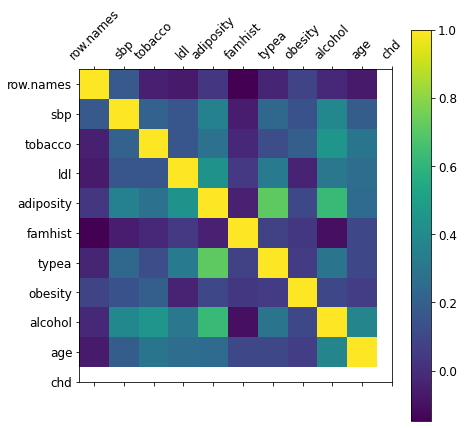

In [4]:
# EDA Question 1: How much is the percentage of each class 0 and 1?
ppc(d=data)

# EDA Question 2: How many missing values do we have?
missing_values_array = data.columns[data.isnull().any()]
print(missing_values_array)
print("No missing values reported.")

# EDA Question 3: How many categorial variables do you have in your features?
data.head()  # Able to count number of categorical variables.
print("Categorical variables in features: 1")
print("Column: famhist")

# EDA Question 4: What features have the maximum correlation?
# Keeping the below in mind:
# 1 indicates a perfectly positive linear correlation between two variables.
comat(d=data)

In [5]:
# One-Hot Encoding: Categorical variables
print("Categorical features are: 'famhist'")
print("One-Hot-Encoding 'famhist'...")
data = onehot_encode(d=data)
print(data)

Categorical features are: 'famhist'
One-Hot-Encoding 'famhist'...
     row.names  sbp  tobacco    ldl  adiposity  typea  obesity  alcohol  age  \
0            1  160    12.00   5.73      23.11     49    25.30    97.20   52   
1            2  144     0.01   4.41      28.61     55    28.87     2.06   63   
2            3  118     0.08   3.48      32.28     52    29.14     3.81   46   
3            4  170     7.50   6.41      38.03     51    31.99    24.26   58   
4            5  134    13.60   3.50      27.78     60    25.99    57.34   49   
..         ...  ...      ...    ...        ...    ...      ...      ...  ...   
457        459  214     0.40   5.98      31.72     64    28.45     0.00   58   
458        460  182     4.20   4.41      32.10     52    28.61    18.72   52   
459        461  108     3.00   1.59      15.23     40    20.09    26.64   55   
460        462  118     5.40  11.61      30.79     64    27.35    23.97   40   
461        463  132     0.00   4.82      33.41     62 

In [6]:
# Using the 'stdard()' function to Standardize the dataframe.
stdard(d=data)
print(data)

     row.names       sbp   tobacco       ldl  adiposity     typea   obesity  \
0            1  1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594   
1            2  0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646   
2            3 -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723   
3            4  1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091   
4            5 -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842   
..         ...       ...       ...       ...        ...       ...       ...   
457        459  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971   
458        460  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942   
459        461 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043   
460        462 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916   
461        463 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210   

      alcohol       age  chd  Absent  Present  
0  

In [7]:
# Initializing theta coefficients between 0 and 1 using random function rand()

theta_index = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
coefficients = pd.DataFrame(theta_index, columns=['theta'])
coefficients['coefficient w'] = coefficients['theta'].transform(lambda x: np.random.rand())

# Splitting our dataframe.
dataFeatures = data[['sbp', 'tobacco', 'ldl', 'adiposity', 'typea', 'obesity', 'alcohol', 'age', 'Absent', 'Present']]
dataTarget = data[['chd']]

In [8]:
# z-values for each row and append z-column to d.
log_odds(d=dataFeatures, w=coefficients)

# p-values for each row and append p-column to d.
prob(d=dataFeatures)

# logloss for initial model.
initloss = logloss(targd=dataTarget, featsd=dataFeatures)
print("Initial logloss:", initloss)

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

In [9]:
# Initializing values for alpha and epoch arrays
alpha = np.array([0.001, 0.0001]) # Learning Rate
epochs = np.array([500, 1000, 10000]) # Number of epochs as mentioned in the lab manual

Running Batch Gradient Descent.....
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Pres

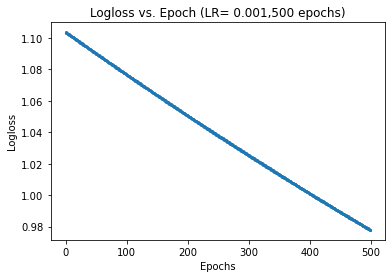

In [10]:
# Batch Gradient Descent, alpha = 0.001, 500 epochs
errors = np.array([])
errors = bgd(w=coefficients, alphaLR=alpha[0], targd=dataTarget, featd=dataFeatures, epochs=epochs[0])

f1 = plot.scatter(range(0, epochs[0]), errors, linewidths=0.1, marker='.')
plot.title('Logloss vs. Epoch (LR= 0.001,500 epochs)')
plot.xlabel('Epochs')
plot.ylabel('Logloss')
plot.show()

Running Batch Gradient Descent.....
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Pres

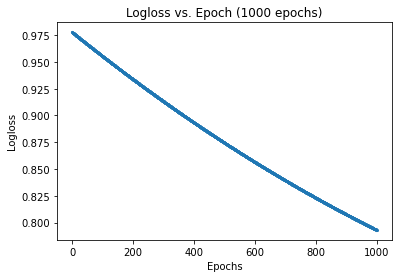

In [11]:
# Batch Gradient Descent, alpha = 0.001, 1000 epochs
errors = np.array([])
errors = bgd(w=coefficients, alphaLR=alpha[0], targd=dataTarget, featd=dataFeatures, epochs=epochs[1])

f2 = plot.scatter(range(0, epochs[1]), errors, linewidths=0.1, marker='.')
plot.title('Logloss vs. Epoch (LR=0.001,1000 epochs)')
plot.xlabel('Epochs')
plot.ylabel('Logloss')
plot.show()

In [12]:
# Batch Gradient Descent, alpha = 0.001, 10000 epochs
errors = np.array([])
errors = bgd(w=coefficients, alphaLR=alpha[0], targd=dataTarget, featd=dataFeatures, epochs=epochs[2])

f3 = plot.scatter(range(0, epochs[2]), errors, linewidths=0.1, marker='.')
plot.title('Logloss vs. Epoch (LR=0.001,10000 epochs)')
plot.xlabel('Epochs')
plot.ylabel('Logloss')
plot.show()

Running Batch Gradient Descent.....
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Pres

KeyboardInterrupt: 

Running Batch Gradient Descent.....
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Pres

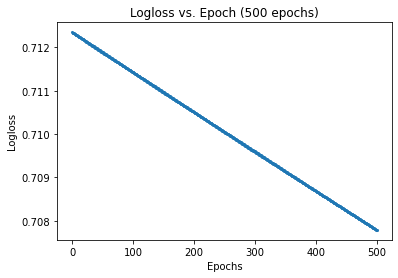

In [13]:
# Batch Gradient Descent, alpha = 0.0001, 500 epochs
errors = np.array([])
errors = bgd(w=coefficients, alphaLR=alpha[1], targd=dataTarget, featd=dataFeatures, epochs=epochs[0])

f4 = plot.scatter(range(0, epochs[0]), errors, linewidths=0.1, marker='.')
plot.title('Logloss vs. Epoch (LR=0.0001,500 epochs)')
plot.xlabel('Epochs')
plot.ylabel('Logloss')
plot.show()

Running Batch Gradient Descent.....
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Pres

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

Epoch: 128 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

[462 rows x 12 columns]
Epoch: 204 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

Epoch: 285 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

Epoch: 369 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

Epoch: 540 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

Epoch: 654 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

Epoch: 742 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

Epoch: 919 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

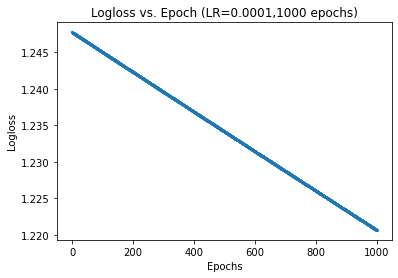

In [10]:
# Batch Gradient Descent, alpha = 0.0001, 1000 epochs
errors = np.array([])
errors = bgd(w=coefficients, alphaLR=alpha[1], targd=dataTarget, featd=dataFeatures, epochs=epochs[1])

f5 = plot.scatter(range(0, epochs[1]), errors, linewidths=0.1, marker='.')
plot.title('Logloss vs. Epoch (LR=0.0001,1000 epochs)')
plot.xlabel('Epochs')
plot.ylabel('Logloss')
plot.show()

In [11]:
# Batch Gradient Descent, alpha = 0.0001, 10000 epochs
errors = np.array([])
errors = bgd(w=coefficients, alphaLR=alpha[1], targd=dataTarget, featd=dataFeatures, epochs=epochs[2])

f6 = plot.scatter(range(0, epochs[2]), errors, linewidths=0.1, marker='.')
plot.title('Logloss vs. Epoch (LR=0.0001,10000 epochs)')
plot.xlabel('Epochs')
plot.ylabel('Logloss')
plot.show()

Running Batch Gradient Descent.....
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Pres

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

KeyboardInterrupt: 

Running Mini-Batch Gradient Descent...
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  P

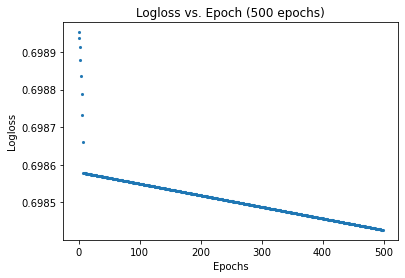

In [16]:
# Mini-Batch Gradient Descent, alpha = 0.001, 500 epochs
errors = mbgd(w=coefficients, alphaLR=alpha[0], targd=dataTarget, featd=dataFeatures, epochs=epochs[0], batchsize=50)

f7 = plot.scatter(range(0, epochs[0]), errors, linewidths=0.1, marker='.')
plot.title('Logloss vs. Epoch (LR=0.001,500 epochs)')
plot.xlabel('Epochs')
plot.ylabel('Logloss')
plot.show()

Running Mini-Batch Gradient Descent...
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  P

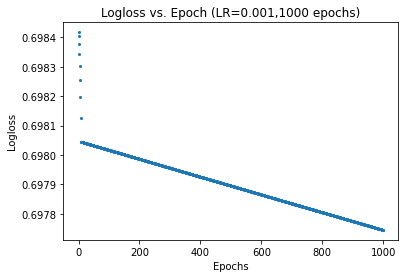

In [17]:
# Mini-Batch Gradient Descent, alpha = 0.001, 1000 epochs
errors = mbgd(w=coefficients, alphaLR=alpha[0], targd=dataTarget, featd=dataFeatures, epochs=epochs[1], batchsize=50)

f8 = plot.scatter(range(0, epochs[1]), errors, linewidths=0.1, marker='.')
plot.title('Logloss vs. Epoch (LR=0.001,1000 epochs)')
plot.xlabel('Epochs')
plot.ylabel('Logloss')
plot.show()

In [12]:
# Mini-Batch Gradient Descent, alpha = 0.001, 10000 epochs
errors = mbgd(w=coefficients, alphaLR=alpha[0], targd=dataTarget, featd=dataFeatures, epochs=epochs[2], batchsize=50)

f9 = plot.scatter(range(0, epochs[2]), errors, linewidths=0.1, marker='.')
plot.title('Logloss vs. Epoch (LR=0.001,10000 epochs)')
plot.xlabel('Epochs')
plot.ylabel('Logloss')
plot.show()

Running Mini-Batch Gradient Descent...
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  P

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

KeyboardInterrupt: 

Running Mini-Batch Gradient Descent...
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  P

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

[462 rows x 11 columns]
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z valu

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

Epoch: 49 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0   

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

[462 rows x 11 columns]
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z valu

[462 rows x 12 columns]
Epoch: 63 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  

[462 rows x 12 columns]
Epoch: 67 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  

Epoch: 71 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0   

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

[462 rows x 12 columns]
Epoch: 84 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

[462 rows x 11 columns]
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z valu

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

[462 rows x 11 columns]
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z valu

[462 rows x 12 columns]
Epoch: 113 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent 

[462 rows x 12 columns]
Epoch: 116 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent 

Epoch: 120 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0  

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

[462 rows x 12 columns]
Epoch: 128 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

[462 rows x 12 columns]
Epoch: 134 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

Epoch: 141 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0  

Epoch: 146 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0  

[462 rows x 12 columns]
Epoch: 150 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

[462 rows x 12 columns]
Epoch: 166 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

[462 rows x 12 columns]
Epoch: 173 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent 

Epoch: 177 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0  

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

[462 rows x 12 columns]
Epoch: 184 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

Epoch: 200 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0  

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

[462 rows x 12 columns]
Epoch: 215 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

Epoch: 228 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0  

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

[462 rows x 12 columns]
Epoch: 235 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

[462 rows x 11 columns]
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z valu

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

[462 rows x 11 columns]
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z valu

[462 rows x 11 columns]
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z valu

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

[462 rows x 12 columns]
Epoch: 274 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

Epoch: 284 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0  

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

Epoch: 304 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0  

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

Epoch: 312 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0  

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

[462 rows x 11 columns]
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z valu

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

Epoch: 346 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0  

Epoch: 350 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0  

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

[462 rows x 12 columns]
Epoch: 370 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

[462 rows x 12 columns]
Epoch: 380 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

Epoch: 390 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0  

Epoch: 394 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0  

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

Epoch: 415 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0  

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

[462 rows x 12 columns]
Epoch: 435 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent 

[462 rows x 11 columns]
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z valu

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

Epoch: 447 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0  

Epoch: 451 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0  

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

Epoch: 465 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0  

[462 rows x 12 columns]
Epoch: 470 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent 

Epoch: 475 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0  

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

[462 rows x 12 columns]
Epoch: 482 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

Epoch: 489 , 500
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0  

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

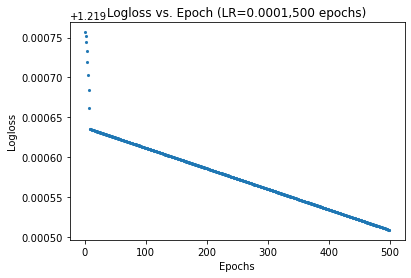

In [13]:
# Mini-Batch Gradient Descent, alpha = 0.0001, 500 epochs
errors = mbgd(w=coefficients, alphaLR=alpha[1], targd=dataTarget, featd=dataFeatures, epochs=epochs[0], batchsize=50)

f10 = plot.scatter(range(0, epochs[0]), errors, linewidths=0.1, marker='.')
plot.title('Logloss vs. Epoch (LR=0.0001,500 epochs)')
plot.xlabel('Epochs')
plot.ylabel('Logloss')
plot.show()

Running Mini-Batch Gradient Descent...
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  P

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

[462 rows x 11 columns]
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z valu

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

[462 rows x 12 columns]
Epoch: 30 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

[462 rows x 12 columns]
Epoch: 58 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

[462 rows x 11 columns]
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z valu

Epoch: 81 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0  

[462 rows x 12 columns]
Epoch: 84 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

[462 rows x 12 columns]
Epoch: 96 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

Epoch: 114 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

Epoch: 118 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

[462 rows x 12 columns]
Epoch: 121 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent

[462 rows x 12 columns]
Epoch: 126 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent

[462 rows x 12 columns]
Epoch: 129 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

[462 rows x 12 columns]
Epoch: 139 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent

[462 rows x 12 columns]
Epoch: 143 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

Epoch: 150 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

Epoch: 168 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

[462 rows x 11 columns]
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z valu

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

Epoch: 213 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

Epoch: 227 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

Epoch: 242 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

Epoch: 246 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

[462 rows x 11 columns]
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z valu

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

[462 rows x 11 columns]
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z valu

Epoch: 272 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

[462 rows x 12 columns]
Epoch: 293 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

Epoch: 302 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

Epoch: 348 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

Epoch: 379 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

[462 rows x 11 columns]
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z valu

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

[462 rows x 11 columns]
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z valu

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

[462 rows x 11 columns]
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z valu

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

Epoch: 423 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

Epoch: 522 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

[462 rows x 12 columns]
Epoch: 525 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

[462 rows x 12 columns]
Epoch: 593 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

Epoch: 599 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

[462 rows x 12 columns]
Epoch: 615 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

Epoch: 621 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

Epoch: 627 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

[462 rows x 11 columns]
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z valu

[462 rows x 12 columns]
Epoch: 658 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

[462 rows x 12 columns]
Epoch: 664 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

[462 rows x 12 columns]
Epoch: 713 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

Epoch: 761 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

[462 rows x 12 columns]
Epoch: 780 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

Epoch: 786 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

Epoch: 793 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

Epoch: 799 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

[462 rows x 11 columns]
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z valu

[462 rows x 12 columns]
Epoch: 807 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

Epoch: 825 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

Epoch: 828 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

Epoch: 831 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

Epoch: 838 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

Epoch: 851 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

Epoch: 861 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

Epoch: 870 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

[462 rows x 12 columns]
Epoch: 888 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent

[462 rows x 12 columns]
Epoch: 892 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

Epoch: 898 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

Epoch: 905 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

Epoch: 908 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

Epoch: 921 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

Epoch: 924 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

Epoch: 928 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

[462 rows x 12 columns]
Epoch: 932 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent

Epoch: 936 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

Epoch: 947 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

Epoch: 950 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

Epoch: 955 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

Epoch: 958 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

[462 rows x 11 columns]
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z valu

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

Epoch: 982 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

[462 rows x 12 columns]
Epoch: 985 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0    0.628654       

          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value   p value  
0    0.628

Epoch: 995 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent  Present   z value  
0 

[462 rows x 12 columns]
Epoch: 998 , 1000
          sbp   tobacco       ldl  adiposity     typea   obesity   alcohol  \
0    1.057417  1.821099  0.477894  -0.295183 -0.418017 -0.176594  3.274189   
1    0.276789 -0.789382 -0.159507   0.411694  0.193134  0.670646 -0.612081   
2   -0.991731 -0.774141 -0.608585   0.883374 -0.112441  0.734723 -0.540597   
3    1.545310  0.841352  0.806252   1.622382 -0.214300  1.411091  0.294742   
4   -0.211103  2.169453 -0.598928   0.305020  0.702427 -0.012842  1.645991   
..        ...       ...       ...        ...       ...       ...       ...   
457  3.692037 -0.704470  0.598614   0.811401  1.109862  0.570971 -0.696228   
458  2.130781  0.122871 -0.159507   0.860240 -0.112441  0.608942  0.068445   
459 -1.479624 -0.138395 -1.521228  -1.307946 -1.334744 -1.413043  0.391960   
460 -0.991731  0.384137  3.317227   0.691875  1.109862  0.309916  0.282897   
461 -0.308682 -0.791559  0.038474   1.028605  0.906144 -2.692210 -0.696228   

          age  Absent

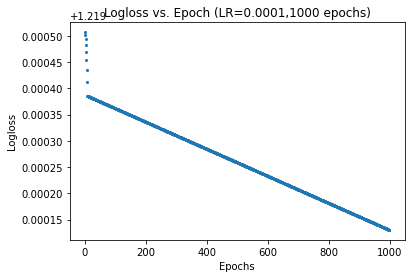

In [14]:
# Mini-Batch Gradient Descent, alpha = 0.0001, 1000 epochs
errors = mbgd(w=coefficients, alphaLR=alpha[1], targd=dataTarget, featd=dataFeatures, epochs=epochs[1], batchsize=50)

f11 = plot.scatter(range(0, epochs[1]), errors, linewidths=0.1, marker='.')
plot.title('Logloss vs. Epoch (LR=0.0001,1000 epochs)')
plot.xlabel('Epochs')
plot.ylabel('Logloss')
plot.show()

In [ ]:
# Mini-Batch Gradient Descent, alpha = 0.0001, 10000 epochs
errors = mbgd(w=coefficients, alphaLR=alpha[1], targd=dataTarget, featd=dataFeatures, epochs=epochs[2], batchsize=50)

f12 = plot.scatter(range(0, epochs[2]), errors, linewidths=0.1, marker='.')
plot.title('Logloss vs. Epoch (LR=0.0001,10000 epochs)')
plot.xlabel('Epochs')
plot.ylabel('Logloss')
plot.show()